<a href="https://colab.research.google.com/github/arashHarirpoosh/AIMedicInternship/blob/main/SemanticSegmentationOnHover_Net.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import Libs

In [ ]:
!pip install -U segmentation-models

In [ ]:
import os
from matplotlib.image import imread
import matplotlib.pyplot as plt
import cv2
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.utils import to_categorical
import scipy.io
import segmentation_models as sm
from segmentation_models.utils import set_trainable
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import ConfusionMatrixDisplay
from skimage.color import label2rgb
from sklearn.utils import class_weight
from sklearn.model_selection import train_test_split
import albumentations as A

sm.set_framework('tf.keras')
keras.backend.set_image_data_format('channels_last')


# Define Required Functions

## Functions Used Before Training

Function That Read The Features And Labels

In [ ]:
def load_data(data_addr, img_dim=128):
  x = []
  y = []

  for root, dirs, files in os.walk(data_addr):
    root_list = root.split('/')
    root_list[-1] = 'Labels'
    root_addr = '/'.join(root_list)
    for name in files:
      addr = os.path.join(root, name)
      label_file = name.replace('.png', '.mat')
      label_addr = f'{root_addr}/{label_file}'
      img = cv2.imread(addr, cv2.COLOR_BGR2RGB)
      labels = scipy.io.loadmat(label_addr)['type_map']
      img = cv2.resize(img, (img_dim, img_dim),
               interpolation = cv2.INTER_NEAREST)
      labels = cv2.resize(labels, (img_dim, img_dim),
               interpolation = cv2.INTER_NEAREST)
      x.append(img[:,:,:3])
      y.append(to_categorical(labels, num_classes=8))
    x = np.array(x)
    y = np.array(y)
    return x, y

Functions For Plotting Semantic Segmentation Images 

In [ ]:
# Plot Segmentation based on input image and pixel labels
def plotSegmentation(img, label):
  label = np.argmax(label, axis=-1)
  res = label2rgb(label=label, image=img, kind='overlay', alpha=0.4)
  # plt.imshow(res)
  return res

# Plot expected and predicted semantic segmentations
def plotSegmentationResult(img, lbl, predicted_lbl):
  plt.figure(figsize=(8, 8))
  f, axarr = plt.subplots(1,2) 
  axarr[0].title.set_text('Expected Segmentation')
  axarr[0].imshow(plotSegmentation(img, lbl))
  axarr[1].title.set_text('Predicted Segmentation')
  axarr[1].imshow(plotSegmentation(img, predicted_lbl))
  plt.show()

# Plot The Semantic Segmentation Of The Whole Dataset
def plotAllSegmentations(imgs, masks):
  n = imgs.shape[0]
  plt.figure()
  r = 4
  c = (n // r) + 1
  #subplot(r,c) provide the no. of rows and columns
  f, axarr = plt.subplots(c, r, figsize=(15,15)) 
  f.tight_layout()
  for w in range(r):
    for h in range(c):
      i = (h * r) + w
      if i < n:
        axarr[h][w].title.set_text('Sampel ' + str(i))
        axarr[h][w].imshow(plotSegmentation(imgs[i], masks[i]), aspect='auto')


  plt.show()


Implementation Of Dice Metric

In [ ]:
def dice_coef(y_true, y_pred, smooth = 1.0):
    y_true_f = keras.backend.flatten(y_true)
    y_pred_f = keras.backend.flatten(y_pred)
    intersection = keras.backend.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (keras.backend.sum(y_true_f) + keras.backend.sum(y_pred_f) + smooth)

## Functions Used After Training

Plot The Training Metrics

In [ ]:
def plotMetricsIOUAndLoss(history):
  plt.figure(figsize=(15, 5))
  plt.subplot(121)
  plt.plot(history.history['iou_score'])
  plt.plot(history.history['val_iou_score'])
  plt.title('Model iou_score')
  plt.ylabel('iou_score')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Test'], loc='upper left')

  # Plot training & validation loss values
  plt.subplot(122)
  plt.plot(history.history['loss'])
  plt.plot(history.history['val_loss'])
  plt.title('Model loss')
  plt.ylabel('Loss')
  plt.xlabel('Epoch')
  plt.legend(['Train', 'Test'], loc='upper left')
  plt.show()

Function That Report The Evaluation Of The Model

In [ ]:
def reportPerformance(model, x, y):
  y_pred = np.argmax(model.predict(x, batch_size=1), axis=-1).flatten()
  y_true = np.argmax(y, axis=-1).flatten()
  print('Confusion Matrix')
  print()
  conf_matrix = confusion_matrix(y_true, y_pred)
  disp = ConfusionMatrixDisplay(confusion_matrix=conf_matrix,
                                        display_labels=range(9))
  fig, ax = plt.subplots(figsize=(10,10))
  disp.plot(ax=ax, cmap=plt.cm.Blues)
  plt.show()
  print()
  print(conf_matrix)
  print()
  print('Classification Report')
  print(classification_report(y_true, y_pred))

# Preparing The DataSet

##Load The DataSet

Download The Dataset

In [ ]:
if not os.path.isfile('consep.zip'):
  !wget https://warwick.ac.uk/fac/cross_fac/tia/data/hovernet/consep.zip

Unzip The DataSet

In [ ]:
if not os.path.isdir('CoNSeP'):
  !unzip consep.zip

##Read The Dataset

Read Train And Test Sampels

In [ ]:
X, y = load_data(data_addr="CoNSeP/Train/Images", img_dim=256)
X_test, y_test = load_data(data_addr="CoNSeP/Test/Images", img_dim=256)

Plot Pixels Class Label Distribution

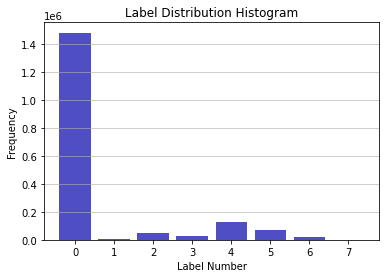

In [ ]:
hist, bin_edges = np.histogram(np.argmax(y, axis=-1), bins=range(9))
n = plt.bar(bin_edges[:-1], hist, color='#0504aa',
                            alpha=0.7)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('Label Number')
plt.ylabel('Frequency')
plt.title('Label Distribution Histogram')
plt.show()

# Data Augmentation

### Perform Augmentation

Specify Augmention Methods

In [ ]:
transform = A.Compose([
    A.HorizontalFlip(p=0.5),
    A.OneOf([
        A.ElasticTransform(p=0.5, alpha=120, sigma=120 * 0.05, alpha_affine=120 * 0.03),
        A.GridDistortion(p=0.5),
    ], p=0.2)])

Augmented The Input Data

In [ ]:
transformed = transform(image=X, mask=y)
transformed_image = transformed['image']
transformed_mask = transformed['mask']


### Plot Images Before And After Augmentation

Plot Images Before Augmentation

<Figure size 432x288 with 0 Axes>

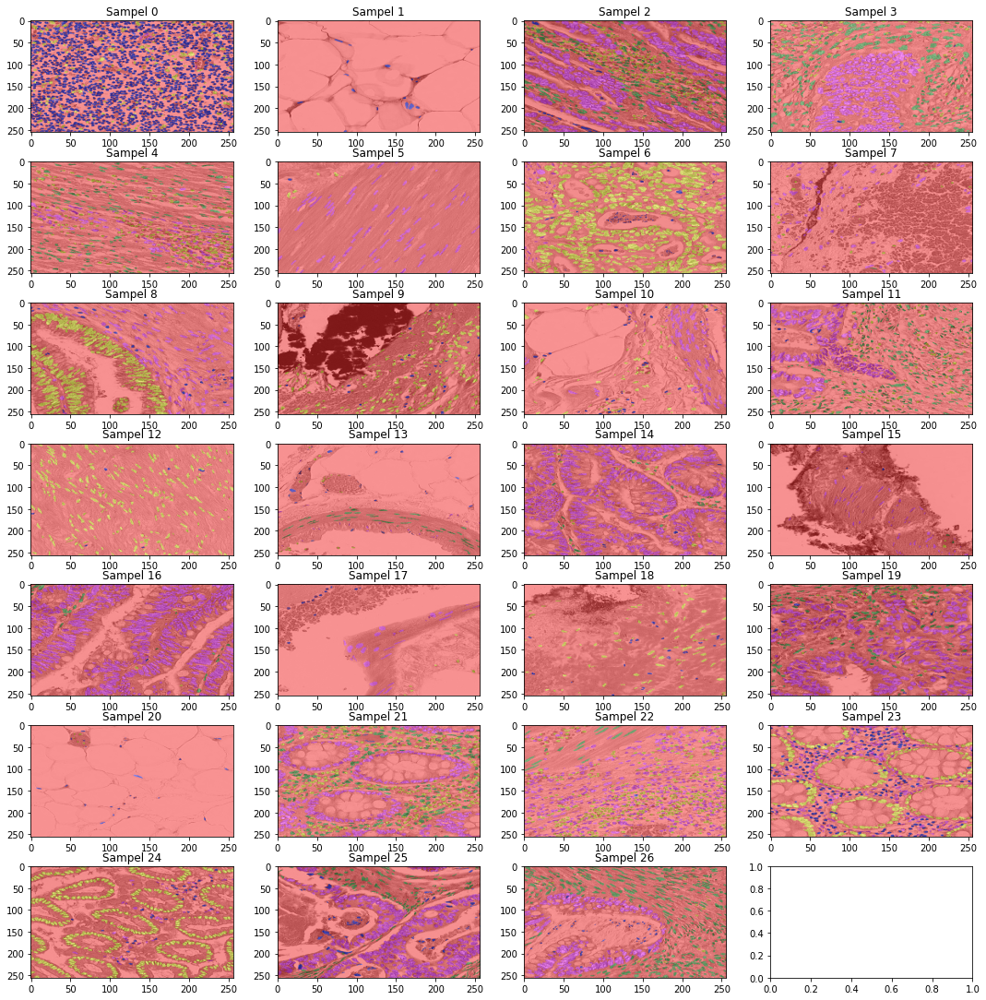

In [ ]:
plotAllSegmentations(X, y)

Plot Images After Augmentation

<Figure size 432x288 with 0 Axes>

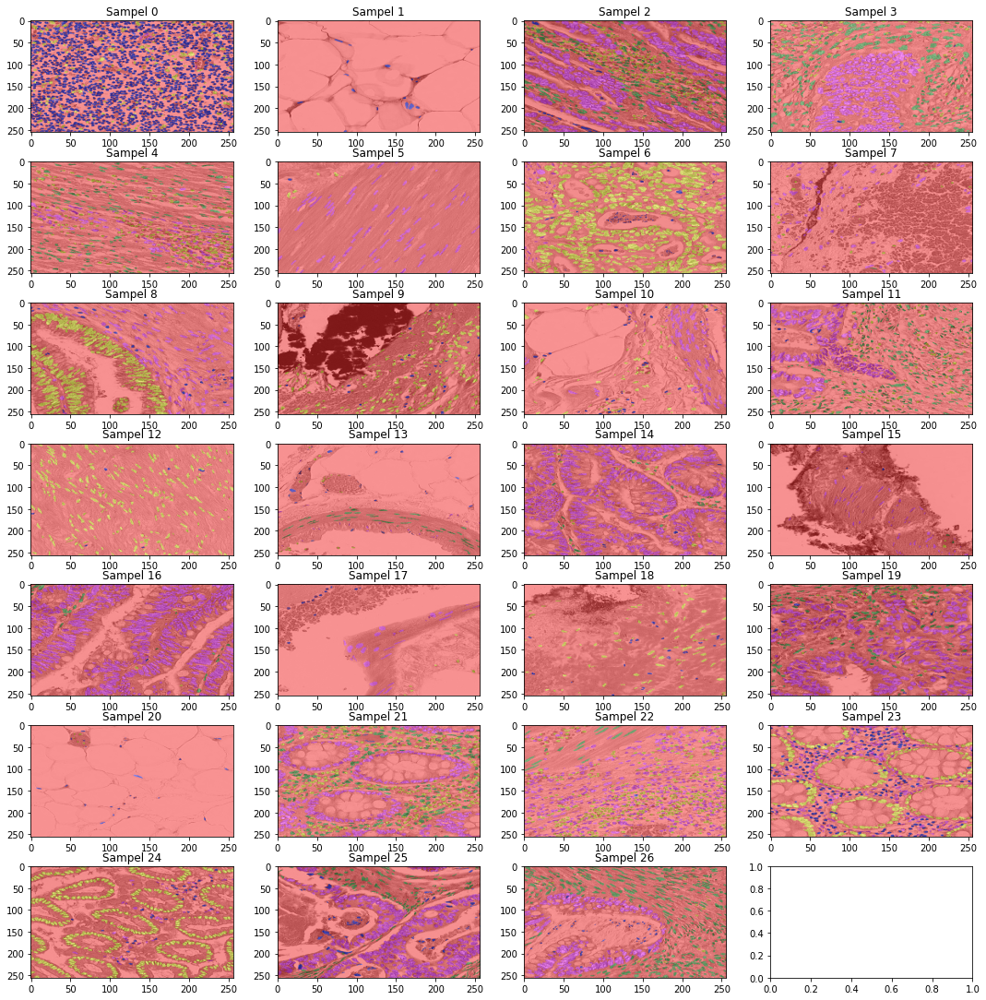

In [ ]:
plotAllSegmentations(transformed_image, transformed_mask)

# First Approach

## Split Dataset To Train And Validation

In [ ]:
# X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42)
X_train, X_val, y_train, y_val = train_test_split(transformed_image, transformed_mask, test_size=0.2, random_state=42)

## U-Net Model

### Fine-Tunning The Model

#### Select The Backbone And Perform Required Preprocesses Due To The Selected Model

In [ ]:
BACKBONE = 'inceptionresnetv2'
preprocess_input = sm.get_preprocessing(BACKBONE)

# preprocess input
x_train = preprocess_input(X_train.copy())
x_val = preprocess_input(X_val.copy())
x_test = preprocess_input(X_test.copy())


#### First Step: Training The Last Layer Of The Model

In [ ]:
# define model
model = sm.Unet(BACKBONE, encoder_weights='imagenet', classes=8, activation='softmax')

all_layers = model.layers 
for l in range(len(all_layers)-2):
  all_layers[l].trainable =  False


callbacks = [
    keras.callbacks.ReduceLROnPlateau(monitor='loss', mode='auto',
                                      factor=0.1, patience=5, min_lr=1e-5),
    # keras.callbacks.EarlyStopping(
    #     monitor="val_loss",
    #     patience=10,
    #     verbose=1,
    #     mode="auto",
    #     # restore_best_weights=True,
    # )
]


dice_loss = sm.losses.DiceLoss() 
focal_loss = sm.losses.CategoricalFocalLoss()
total_loss = 0 * dice_loss + (1 * focal_loss)

model.compile(
    optimizer=keras.optimizers.Adam(),
    loss=total_loss,
    metrics=[
             sm.metrics.IOUScore(threshold=0.5), 
             dice_coef, 'accuracy',
             sm.metrics.FScore(threshold=0.5)],
)
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [ ]:
# fit model
last_layers_history = model.fit(
   x=x_train,
   y=y_train,
   batch_size=1,
   epochs=20,
   callbacks=callbacks,
   validation_data=(x_val, y_val)
)


Epoch 1/20
21/21 [==============================] - 22s 325ms/step - loss: 0.0476 - iou_score: 0.3721 - dice_coef: 0.1726 - accuracy: 0.1495 - f1-score: 0.3748 - val_loss: 0.0250 - val_iou_score: 0.3327 - val_dice_coef: 0.3360 - val_accuracy: 0.6306 - val_f1-score: 0.3470
Epoch 2/20
21/21 [==============================] - 3s 124ms/step - loss: 0.0160 - iou_score: 0.4994 - dice_coef: 0.4726 - accuracy: 0.8160 - f1-score: 0.5160 - val_loss: 0.0197 - val_iou_score: 0.5100 - val_dice_coef: 0.5427 - val_accuracy: 0.8095 - val_f1-score: 0.5232
Epoch 3/20
21/21 [==============================] - 3s 123ms/step - loss: 0.0135 - iou_score: 0.5489 - dice_coef: 0.5629 - accuracy: 0.8438 - f1-score: 0.5610 - val_loss: 0.0189 - val_iou_score: 0.5102 - val_dice_coef: 0.5400 - val_accuracy: 0.8091 - val_f1-score: 0.5233
Epoch 4/20
21/21 [==============================] - 2s 114ms/step - loss: 0.0129 - iou_score: 0.5076 - dice_coef: 0.5371 - accuracy: 0.8427 - f1-score: 0.5216 - val_loss: 0.0194 - val

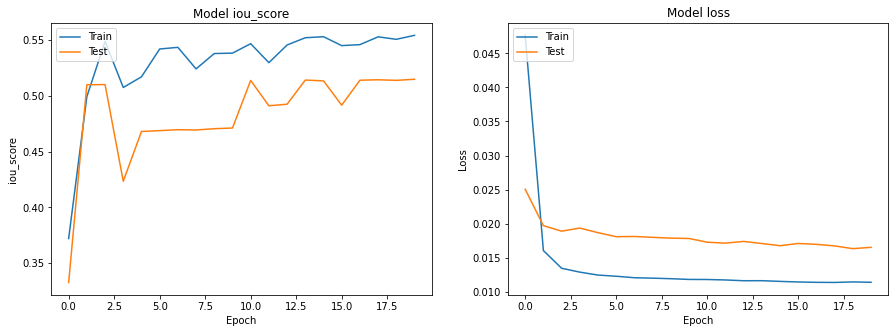

In [ ]:
plotMetricsIOUAndLoss(last_layers_history)

#### Second Step: Training All Layers Of The Model

In [ ]:
callbacks = [
    keras.callbacks.ReduceLROnPlateau(monitor='loss', mode='auto',
                                      factor=0.1, patience=5, min_lr=1e-9),
    # keras.callbacks.EarlyStopping(
    #     monitor="val_loss",
    #     patience=10,
    #     verbose=1,
    #     mode="auto",
    #     # restore_best_weights=True,
    # )
]

# Unfreeze the base model
model.trainable = True
model.compile(optimizer=keras.optimizers.Adam(1e-4),
              loss=total_loss,
              metrics=[
                      sm.metrics.IOUScore(threshold=0.5), 
                      dice_coef, 'accuracy',
                      sm.metrics.FScore(threshold=0.5)],
)
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, None, None, 3 864         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, None, None, 3 96          conv2d[0][0]                     
__________________________________________________________________________________________________
activation (Activation)         (None, None, None, 3 0           batch_normalization[0][0]        
______________________________________________________________________________________________

In [ ]:
# continue training
res_finetuning = model.fit(
   x=x_train,
   y=y_train,
   batch_size=1,
   epochs=30,
   callbacks=callbacks,
   validation_data=(x_val, y_val)
  )

Epoch 1/30
21/21 [==============================] - 34s 523ms/step - loss: 0.0179 - iou_score: 0.4369 - dice_coef: 0.7508 - accuracy: 0.8358 - f1-score: 0.4474 - val_loss: 0.0166 - val_iou_score: 0.5000 - val_dice_coef: 0.4946 - val_accuracy: 0.8091 - val_f1-score: 0.5164
Epoch 2/30
21/21 [==============================] - 7s 328ms/step - loss: 0.0124 - iou_score: 0.4259 - dice_coef: 0.7352 - accuracy: 0.8321 - f1-score: 0.4375 - val_loss: 0.0171 - val_iou_score: 0.4741 - val_dice_coef: 0.4356 - val_accuracy: 0.8073 - val_f1-score: 0.4950
Epoch 3/30
21/21 [==============================] - 7s 322ms/step - loss: 0.0109 - iou_score: 0.4190 - dice_coef: 0.7209 - accuracy: 0.8327 - f1-score: 0.4310 - val_loss: 0.0175 - val_iou_score: 0.4633 - val_dice_coef: 0.4381 - val_accuracy: 0.8012 - val_f1-score: 0.4835
Epoch 4/30
21/21 [==============================] - 7s 330ms/step - loss: 0.0095 - iou_score: 0.4446 - dice_coef: 0.7265 - accuracy: 0.8411 - f1-score: 0.4558 - val_loss: 0.0168 - val

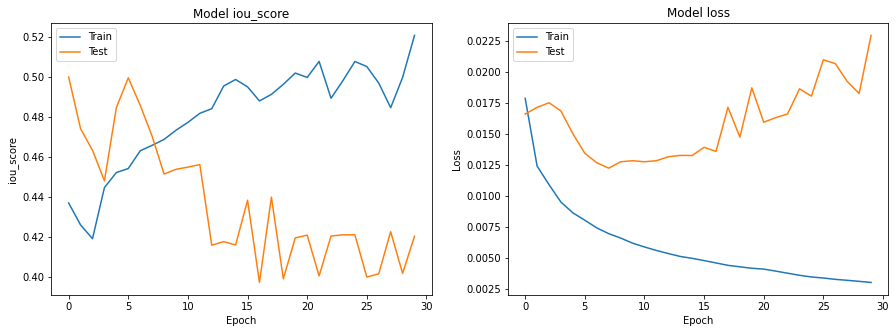

In [ ]:
plotMetricsIOUAndLoss(res_finetuning)

### Model Evaluation

Measure Evaluation Metrics Of The Model On Test Dataset

In [ ]:
_, iou, dice, acc, f1 = model.evaluate(x_test, y_test, batch_size=1)
print(f' IOU: {iou},\n Dice: {dice}, \n Accuracy: {acc}, \n F1-Score: {f1} \n For Test Dataset')

14/14 [==============================] - 1s 86ms/step - loss: 0.0116 - iou_score: 0.4337 - dice_coef: 0.6655 - accuracy: 0.8051 - f1-score: 0.4555
 IOU: 0.43371614813804626,
 Dice: 0.6654582619667053, 
 Accuracy: 0.8050515055656433, 
 F1-Score: 0.45547452569007874 
 For Test Dataset


Report Classification And Confusion Matrix On Train Dataset

Confusion Matrix



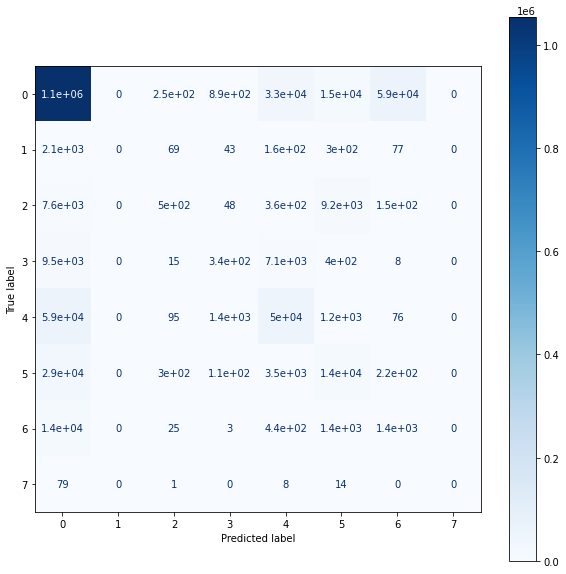


[[1053530       0     248     892   32992   14534   59341       0]
 [   2143       0      69      43     156     299      77       0]
 [   7561       0     502      48     363    9229     152       0]
 [   9479       0      15     345    7110     398       8       0]
 [  58985       0      95    1432   50127    1241      76       0]
 [  28619       0     296     108    3465   14262     220       0]
 [  14401       0      25       3     445    1435    1385       0]
 [     79       0       1       0       8      14       0       0]]

Classification Report


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.90      0.91      0.90   1161537
           1       0.00      0.00      0.00      2787
           2       0.40      0.03      0.05     17855
           3       0.12      0.02      0.03     17355
           4       0.53      0.45      0.49    111956
           5       0.34      0.30      0.32     46970
           6       0.02      0.08      0.04     17694
           7       0.00      0.00      0.00       102

    accuracy                           0.81   1376256
   macro avg       0.29      0.22      0.23   1376256
weighted avg       0.82      0.81      0.81   1376256



In [ ]:
reportPerformance(model, x_train, y_train)

Report Classification And Confusion Matrix On Test Dataset

Confusion Matrix



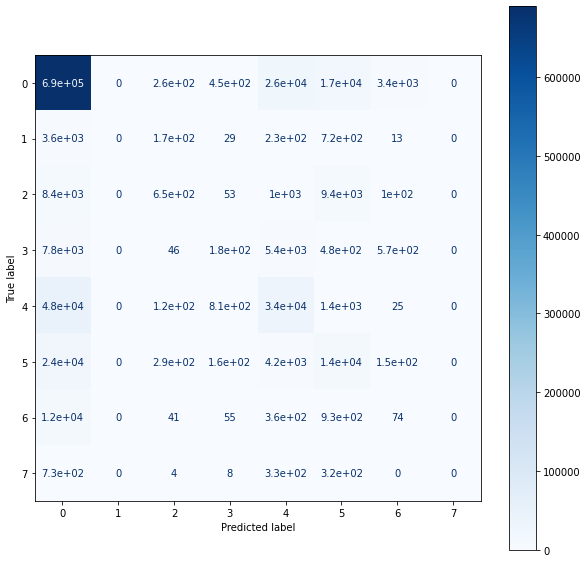


[[690104      0    259    451  26147  17225   3447      0]
 [  3617      0    170     29    229    717     13      0]
 [  8416      0    650     53   1000   9388    100      0]
 [  7812      0     46    177   5354    475    571      0]
 [ 47978      0    123    812  33794   1391     25      0]
 [ 23766      0    288    162   4207  13839    152      0]
 [ 11658      0     41     55    362    929     74      0]
 [   730      0      4      8    331    325      0      0]]

Classification Report


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

           0       0.87      0.94      0.90    737633
           1       0.00      0.00      0.00      4775
           2       0.41      0.03      0.06     19607
           3       0.10      0.01      0.02     14435
           4       0.47      0.40      0.43     84123
           5       0.31      0.33      0.32     42414
           6       0.02      0.01      0.01     13119
           7       0.00      0.00      0.00      1398

    accuracy                           0.81    917504
   macro avg       0.27      0.21      0.22    917504
weighted avg       0.77      0.81      0.78    917504



In [ ]:
reportPerformance(model, x_test, y_test)

### Plot Segmentation Results 

#### Semantic Segmentation On Train Dataset

Expected Results

<Figure size 432x288 with 0 Axes>

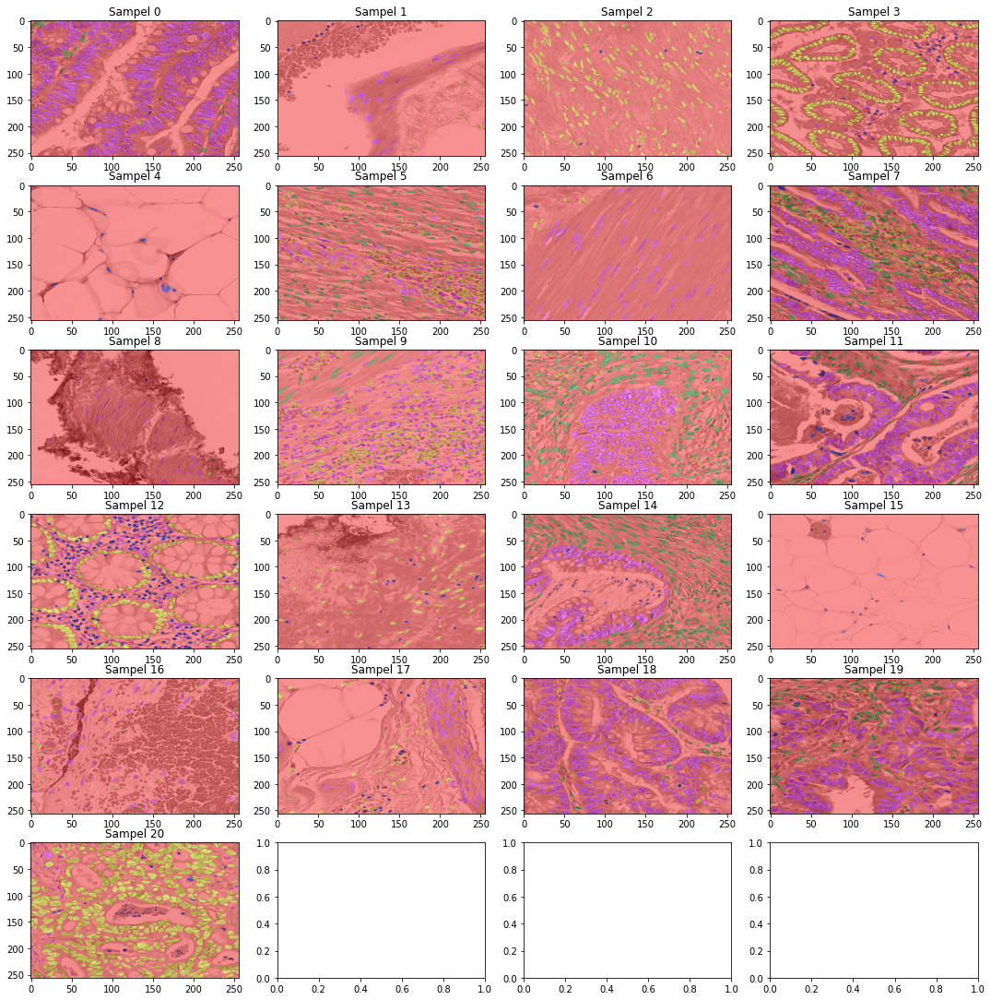

In [ ]:
plotAllSegmentations(X_train, y_train)

Predicted Results

<Figure size 432x288 with 0 Axes>

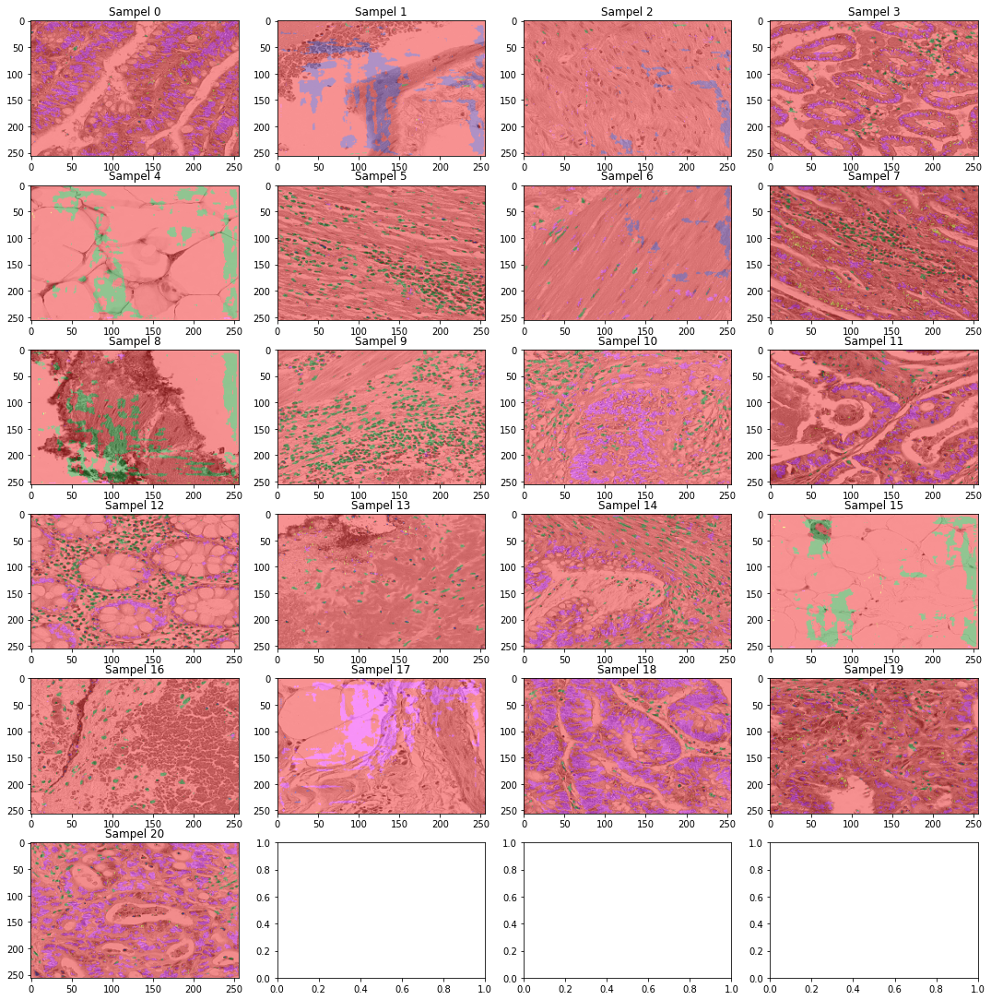

In [ ]:
pred = model.predict(x_train, batch_size=1)
plotAllSegmentations(X_train, pred)

#### Semantic Segmentation On Test Dataset

Expected Results

<Figure size 432x288 with 0 Axes>

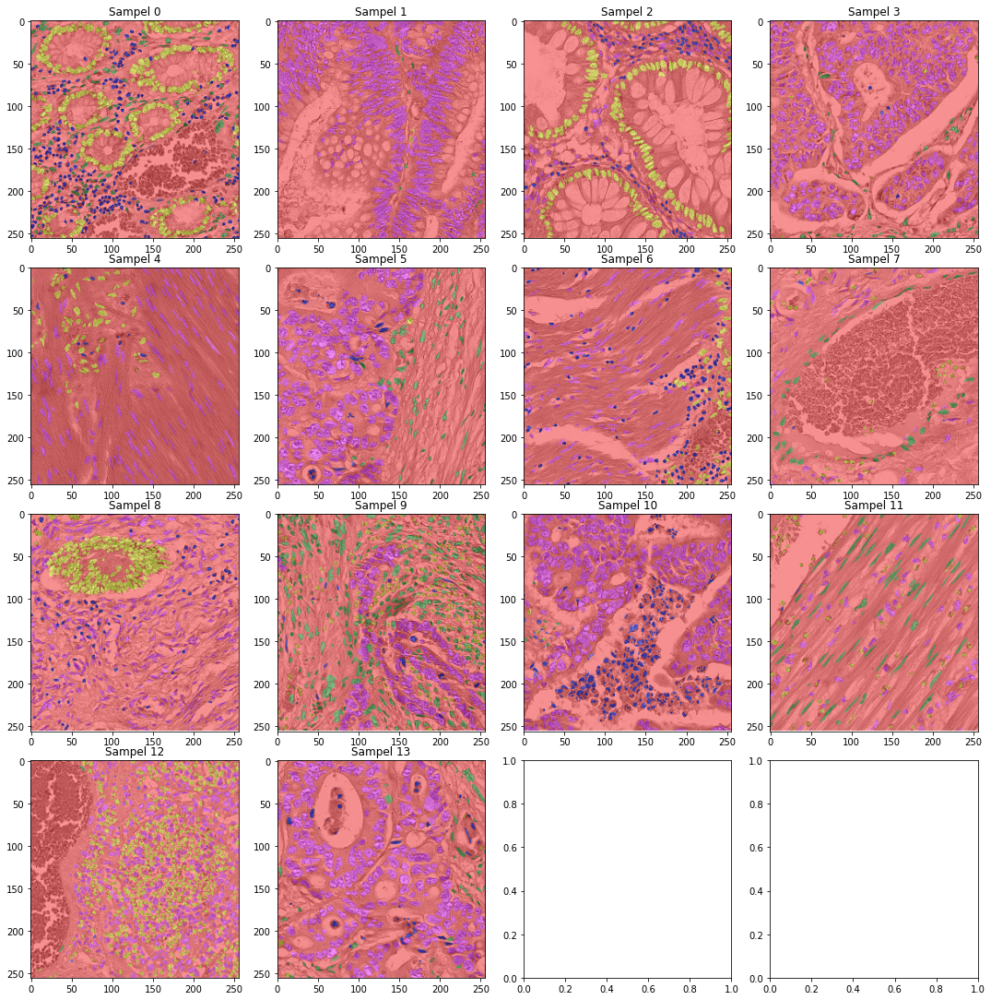

In [ ]:
plotAllSegmentations(X_test, y_test)

Predicted Results

<Figure size 432x288 with 0 Axes>

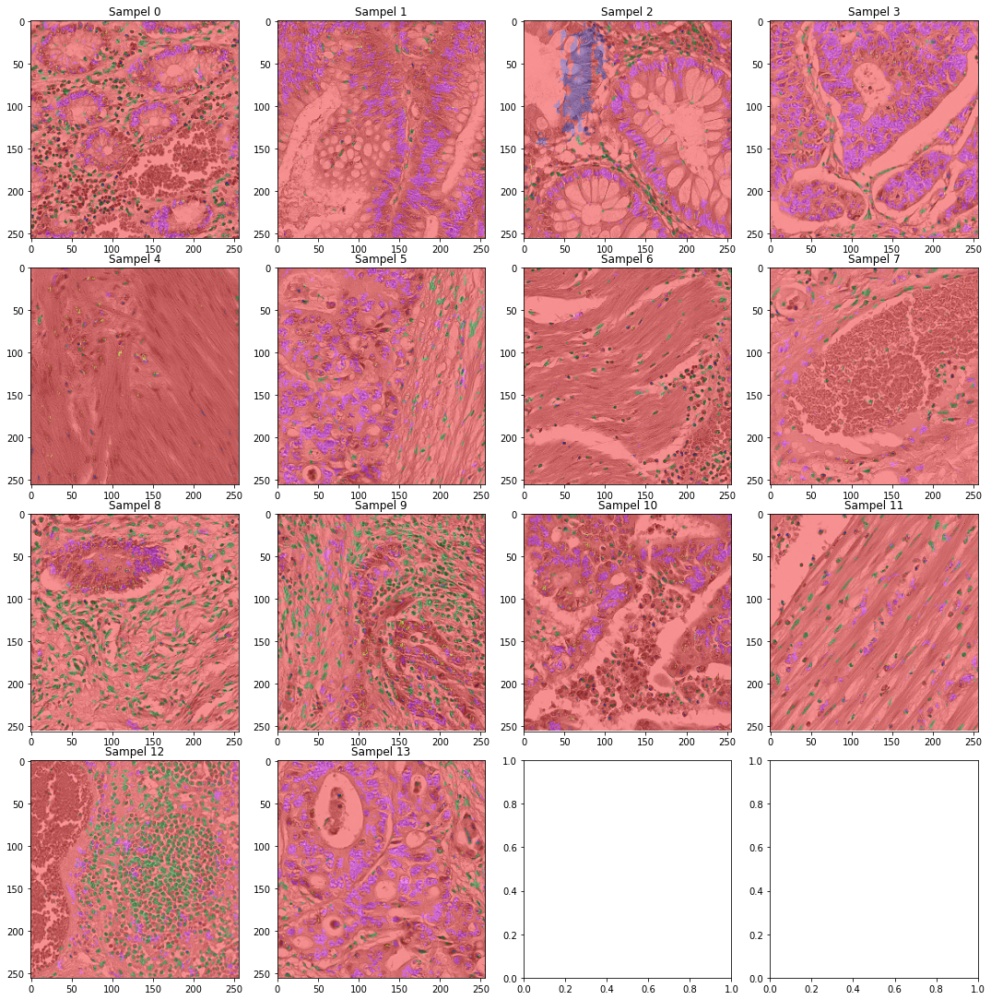

In [ ]:
plotAllSegmentations(X_test, model.predict(x_test, batch_size=1))

# Second Approach

## Combine Labels (3,4) and (5, 6, 7) with each other

In [ ]:
lbl = np.argmax(y, axis=-1)
lbl_test = np.argmax(y_test, axis=-1)

In [ ]:
lbl[lbl == 4] = 3
lbl[lbl == 5] = 4
lbl[lbl == 6] = 4
lbl[lbl == 7] = 4

lbl_test[lbl_test == 4] = 3
lbl_test[lbl_test == 5] = 4
lbl_test[lbl_test == 6] = 4
lbl_test[lbl_test == 7] = 4

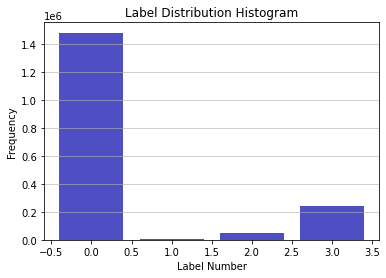

In [ ]:
hist, bin_edges = np.histogram(lbl, bins=range(5))
n = plt.bar(bin_edges[:-1], hist, color='#0504aa',
                            alpha=0.7)
plt.grid(axis='y', alpha=0.75)
plt.xlabel('Label Number')
plt.ylabel('Frequency')
plt.title('Label Distribution Histogram')
plt.show()

In [ ]:
y_new = to_categorical(lbl)
y_test_new = to_categorical(lbl_test)

## Augmented The New Imaged And Masks

In [ ]:
transformed = transform(image=X, mask=y_new)
transformed_image = transformed['image']
transformed_mask = transformed['mask']

## Split Train Dataset To Train And Validation

In [ ]:
X_train, X_val, y_train, y_val = train_test_split(transformed_image, transformed_mask, test_size=0.2, random_state=42)

## Plot Images Before And After Augmentation

Plot Images Before Augmentation

<Figure size 432x288 with 0 Axes>

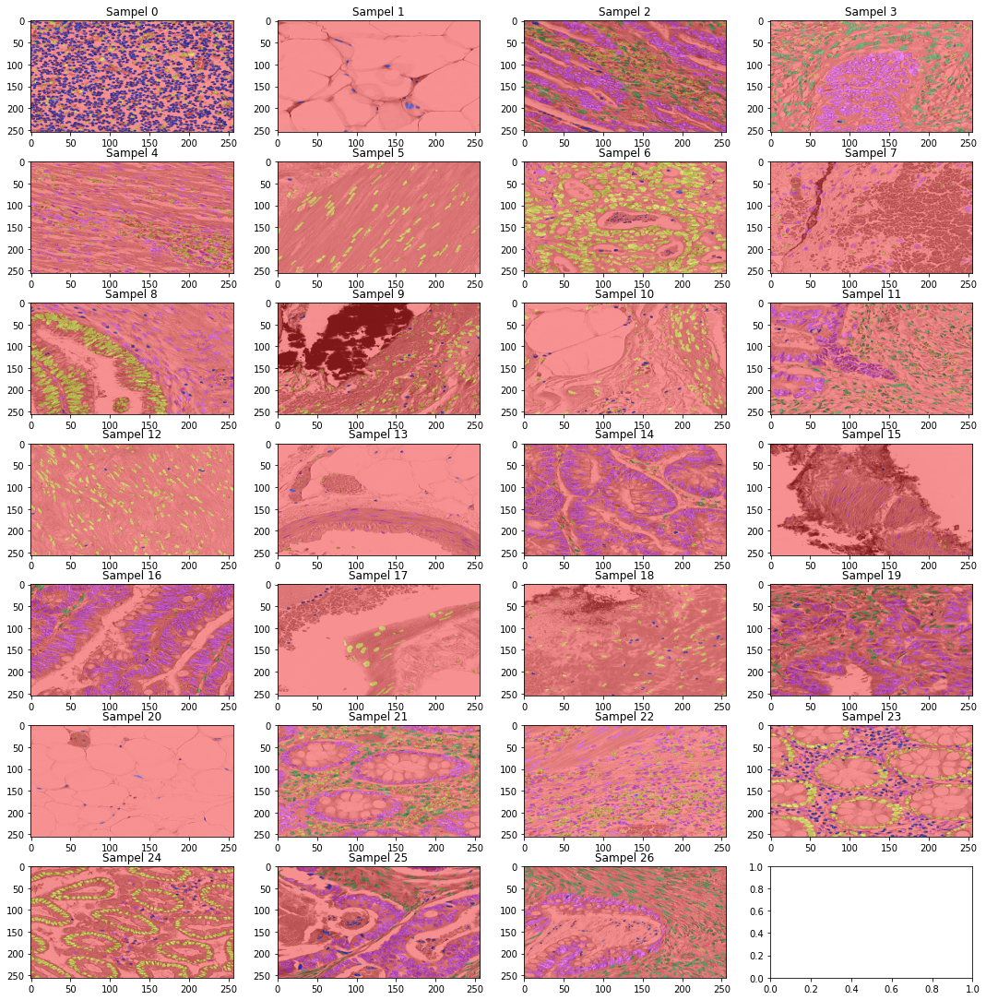

In [ ]:
plotAllSegmentations(X, y_new)

Plot Images After Augmentation

<Figure size 432x288 with 0 Axes>

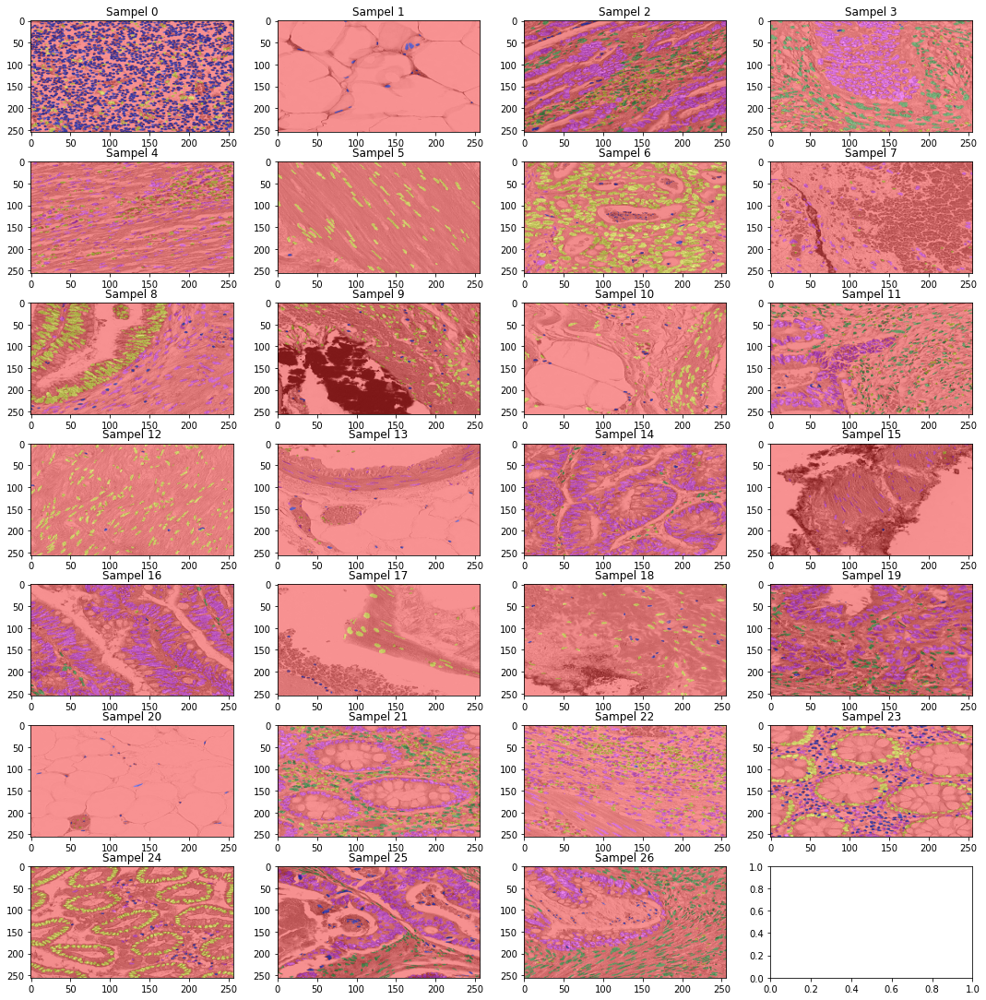

In [ ]:
plotAllSegmentations(transformed_image, transformed_mask)

## U-Net Model

### Fine-Tunning The Model

#### Select The Backbone And Perform Required Preprocesses Due To The Selected Model

In [ ]:
if model:
  del model
BACKBONE = 'inceptionresnetv2'
preprocess_input = sm.get_preprocessing(BACKBONE)

# preprocess input
x_train = preprocess_input(X_train)
x_val = preprocess_input(X_val)
x_test = preprocess_input(X_test.copy())


#### First Step: Training The Last Layer Of The Model

In [ ]:
# define model
model = sm.Unet(BACKBONE, encoder_weights='imagenet', classes=5, activation='softmax')

all_layers = model.layers 
for l in range(len(all_layers)-2):
  all_layers[l].trainable =  False


callbacks = [
    keras.callbacks.ReduceLROnPlateau(monitor='loss', mode='auto',
                                      factor=0.1, patience=5, min_lr=1e-5),
    # keras.callbacks.EarlyStopping(
    #     monitor="val_loss",
    #     patience=10,
    #     verbose=1,
    #     mode="auto",
    #     # restore_best_weights=True,
    # )
]


dice_loss = sm.losses.DiceLoss() 
focal_loss = sm.losses.CategoricalFocalLoss()
total_loss = 0 * dice_loss + (1 * focal_loss)

model.compile(
    optimizer=keras.optimizers.Adam(),
    loss=total_loss,
    metrics=[
             sm.metrics.IOUScore(threshold=0.5), 
             dice_coef, 'accuracy',
             sm.metrics.FScore(threshold=0.5)],
)
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_203 (Conv2D)             (None, None, None, 3 864         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_203 (BatchN (None, None, None, 3 96          conv2d_203[0][0]                 
__________________________________________________________________________________________________
activation_203 (Activation)     (None, None, None, 3 0           batch_normalization_203[0][0]    
____________________________________________________________________________________________

In [ ]:
# fit model
last_layers_history = model.fit(
   x=x_train,
   y=y_train,
   batch_size=1,
   epochs=20,
   callbacks=callbacks,
   validation_data=(x_val, y_val)
)


Epoch 1/20
21/21 [==============================] - 20s 340ms/step - loss: 0.0623 - iou_score: 0.1134 - dice_coef: 0.2882 - accuracy: 0.3022 - f1-score: 0.1304 - val_loss: 0.0255 - val_iou_score: 0.2442 - val_dice_coef: 0.5582 - val_accuracy: 0.7825 - val_f1-score: 0.2681
Epoch 2/20
21/21 [==============================] - 3s 122ms/step - loss: 0.0194 - iou_score: 0.2536 - dice_coef: 0.6067 - accuracy: 0.8343 - f1-score: 0.2716 - val_loss: 0.0261 - val_iou_score: 0.2496 - val_dice_coef: 0.5727 - val_accuracy: 0.7910 - val_f1-score: 0.2713
Epoch 3/20
21/21 [==============================] - 3s 122ms/step - loss: 0.0172 - iou_score: 0.2207 - dice_coef: 0.5475 - accuracy: 0.8057 - f1-score: 0.2471 - val_loss: 0.0267 - val_iou_score: 0.2459 - val_dice_coef: 0.5510 - val_accuracy: 0.7785 - val_f1-score: 0.2703
Epoch 4/20
21/21 [==============================] - 2s 113ms/step - loss: 0.0167 - iou_score: 0.2392 - dice_coef: 0.5759 - accuracy: 0.8266 - f1-score: 0.2604 - val_loss: 0.0264 - val

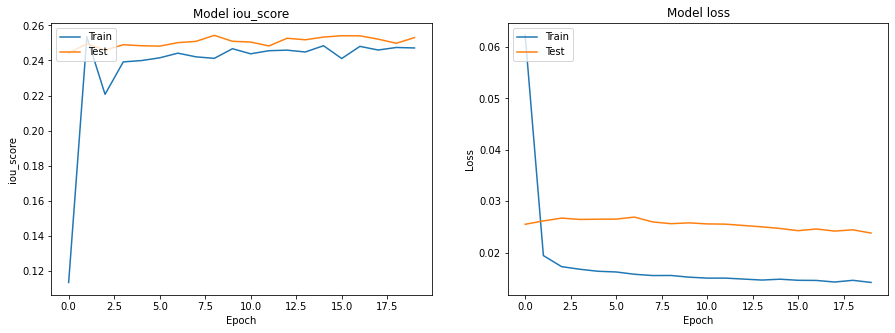

In [ ]:
plotMetricsIOUAndLoss(last_layers_history)

#### Second Step: Training All Layers Of The Model

In [ ]:
callbacks = [
    keras.callbacks.ReduceLROnPlateau(monitor='loss', mode='auto',
                                      factor=0.1, patience=5, min_lr=1e-9),
    # keras.callbacks.EarlyStopping(
    #     monitor="val_loss",
    #     patience=10,
    #     verbose=1,
    #     mode="auto",
    #     # restore_best_weights=True,
    # )
]

# Unfreeze the base model
model.trainable = True
model.compile(optimizer=keras.optimizers.Adam(1e-4),
              loss=total_loss,
              metrics=[
                      sm.metrics.IOUScore(threshold=0.5), 
                      dice_coef, 'accuracy',
                      sm.metrics.FScore(threshold=0.5)],
)
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_2 (InputLayer)            [(None, None, None,  0                                            
__________________________________________________________________________________________________
conv2d_203 (Conv2D)             (None, None, None, 3 864         input_2[0][0]                    
__________________________________________________________________________________________________
batch_normalization_203 (BatchN (None, None, None, 3 96          conv2d_203[0][0]                 
__________________________________________________________________________________________________
activation_203 (Activation)     (None, None, None, 3 0           batch_normalization_203[0][0]    
____________________________________________________________________________________________

In [ ]:
# continue training
res_finetuning = model.fit(
   x=x_train,
   y=y_train,
   batch_size=1,
   epochs=30,
   callbacks=callbacks,
   validation_data=(x_val, y_val)
  )

Epoch 1/30
21/21 [==============================] - 32s 525ms/step - loss: 0.0197 - iou_score: 0.1840 - dice_coef: 0.5919 - accuracy: 0.7668 - f1-score: 0.2152 - val_loss: 0.0214 - val_iou_score: 0.2564 - val_dice_coef: 0.6011 - val_accuracy: 0.7984 - val_f1-score: 0.2758
Epoch 2/30
21/21 [==============================] - 7s 331ms/step - loss: 0.0146 - iou_score: 0.2162 - dice_coef: 0.6223 - accuracy: 0.8036 - f1-score: 0.2459 - val_loss: 0.0202 - val_iou_score: 0.2553 - val_dice_coef: 0.6076 - val_accuracy: 0.8030 - val_f1-score: 0.2746
Epoch 3/30
21/21 [==============================] - 7s 331ms/step - loss: 0.0125 - iou_score: 0.2333 - dice_coef: 0.6447 - accuracy: 0.8253 - f1-score: 0.2615 - val_loss: 0.0188 - val_iou_score: 0.2509 - val_dice_coef: 0.5969 - val_accuracy: 0.7973 - val_f1-score: 0.2730
Epoch 4/30
21/21 [==============================] - 7s 331ms/step - loss: 0.0111 - iou_score: 0.2499 - dice_coef: 0.6591 - accuracy: 0.8393 - f1-score: 0.2780 - val_loss: 0.0182 - val

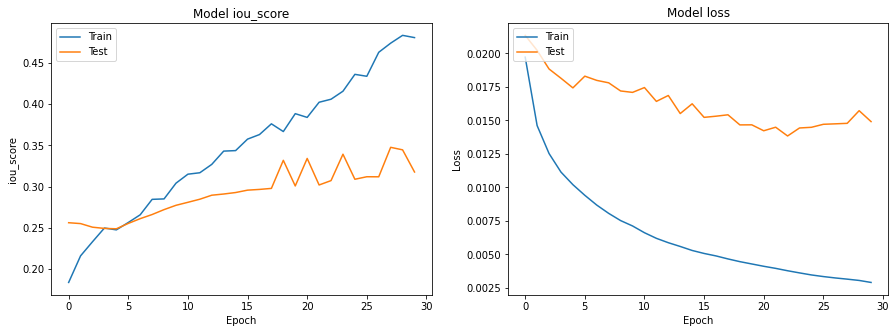

In [ ]:
plotMetricsIOUAndLoss(res_finetuning)

### Model Evaluation

Measure Evaluation Metrics Of The Model On Test Dataset

In [ ]:
_, iou, dice, acc, f1 = model.evaluate(x_test, y_test_new, batch_size=1)
print(f' IOU: {iou},\n Dice: {dice}, \n Accuracy: {acc}, \n F1-Score: {f1} \n For Test Dataset')

14/14 [==============================] - 1s 96ms/step - loss: 0.0130 - iou_score: 0.2995 - dice_coef: 0.7072 - accuracy: 0.8317 - f1-score: 0.3537
 IOU: 0.29948729276657104,
 Dice: 0.7071631550788879, 
 Accuracy: 0.8317031860351562, 
 F1-Score: 0.3537093997001648 
 For Test Dataset


Report Classification And Confusion Matrix On Train Dataset

Confusion Matrix



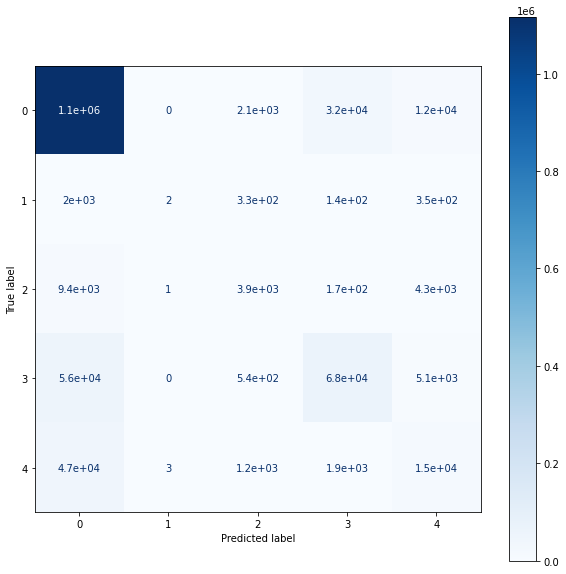


[[1115836       0    2077   32038   11586]
 [   1960       2     334     143     348]
 [   9431       1    3912     166    4345]
 [  55676       0     537   67960    5138]
 [  46925       3    1234    1907   14697]]

Classification Report
              precision    recall  f1-score   support

           0       0.91      0.96      0.93   1161537
           1       0.33      0.00      0.00      2787
           2       0.48      0.22      0.30     17855
           3       0.66      0.53      0.59    129311
           4       0.41      0.23      0.29     64766

    accuracy                           0.87   1376256
   macro avg       0.56      0.39      0.42   1376256
weighted avg       0.85      0.87      0.86   1376256



In [ ]:
reportPerformance(model, x_train, y_train)

Report Classification And Confusion Matrix On Test Dataset

Confusion Matrix



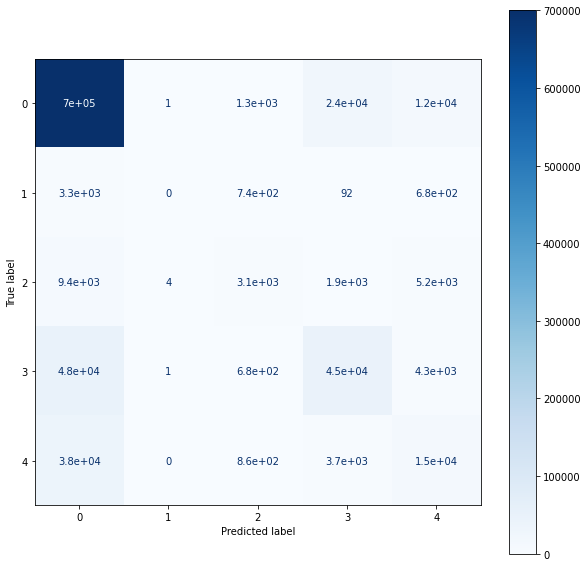


[[700011      1   1326  24451  11844]
 [  3258      0    745     92    680]
 [  9365      4   3149   1922   5167]
 [ 48360      1    680  45215   4302]
 [ 37665      0    864   3686  14716]]

Classification Report
              precision    recall  f1-score   support

           0       0.88      0.95      0.91    737633
           1       0.00      0.00      0.00      4775
           2       0.47      0.16      0.24     19607
           3       0.60      0.46      0.52     98558
           4       0.40      0.26      0.31     56931

    accuracy                           0.83    917504
   macro avg       0.47      0.37      0.40    917504
weighted avg       0.80      0.83      0.81    917504



In [ ]:
reportPerformance(model, x_test, y_test_new)

### Plot Segmentation Results 

#### Semantic Segmentation On Train Dataset

Expected Results

<Figure size 432x288 with 0 Axes>

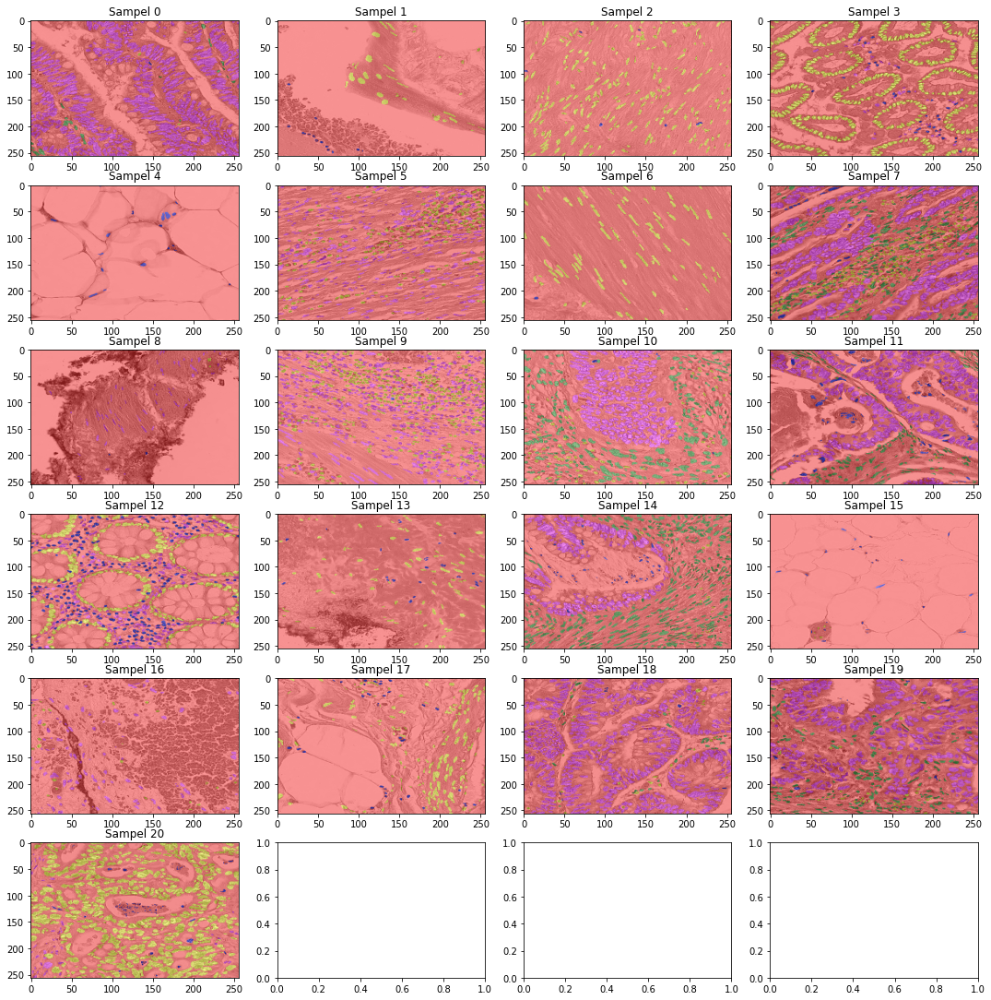

In [ ]:
plotAllSegmentations(X_train, y_train)

Predicted Results

<Figure size 432x288 with 0 Axes>

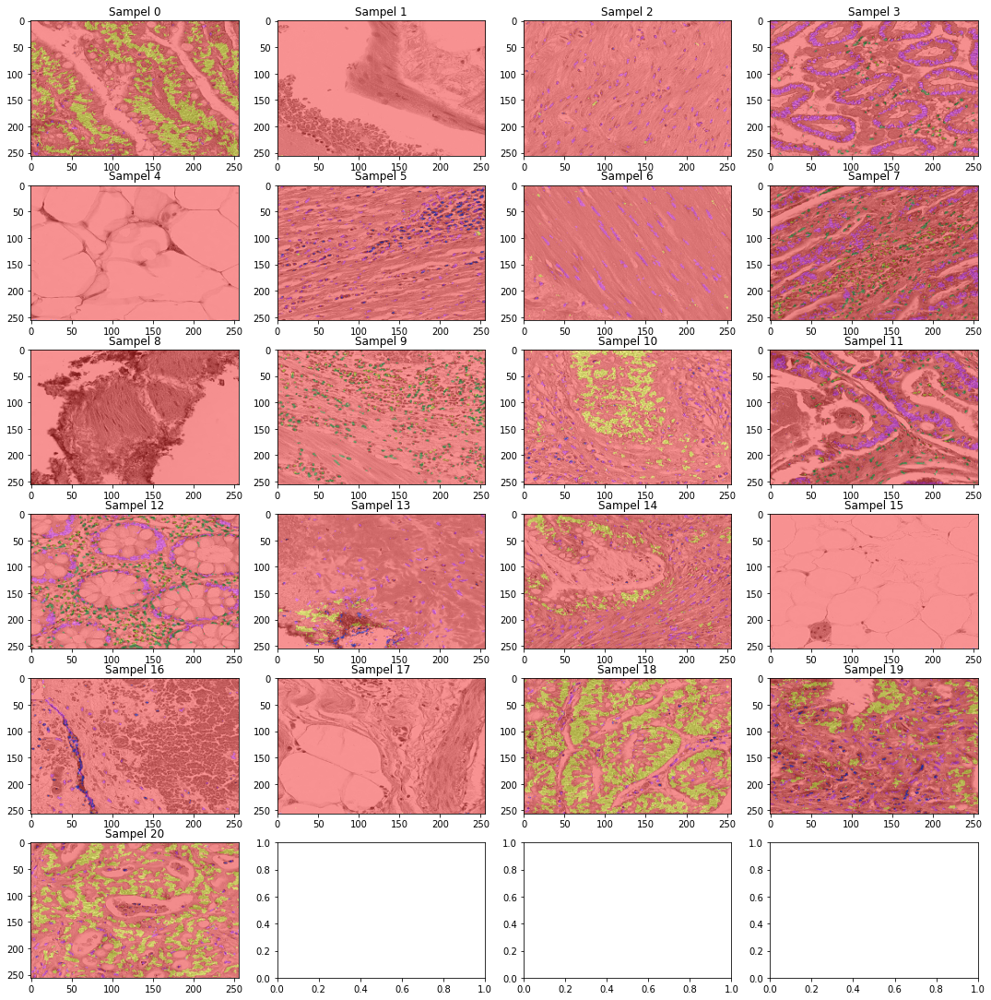

In [ ]:
plotAllSegmentations(X_train, model.predict(x_train, batch_size=1))

#### Semantic Segmentation On Test Dataset

Expected Results

<Figure size 432x288 with 0 Axes>

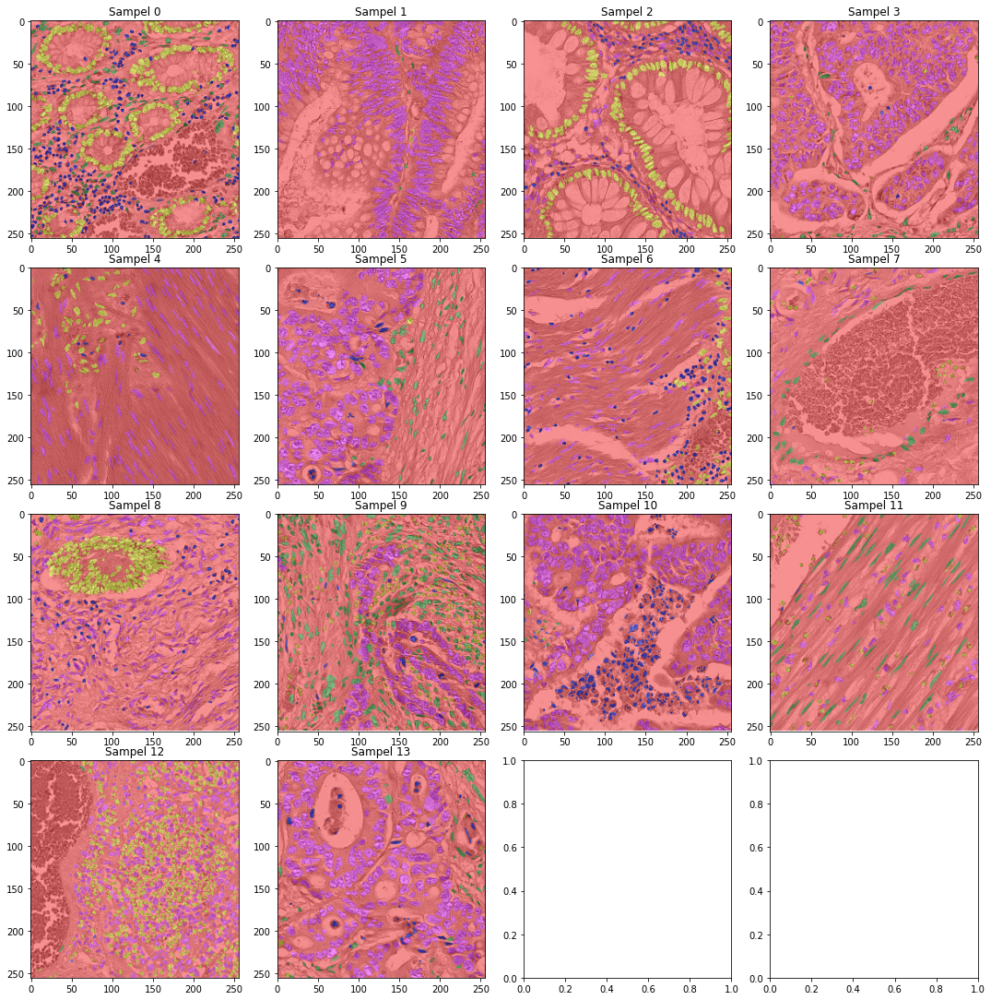

In [ ]:
plotAllSegmentations(X_test, y_test)

Predicted Results

<Figure size 432x288 with 0 Axes>

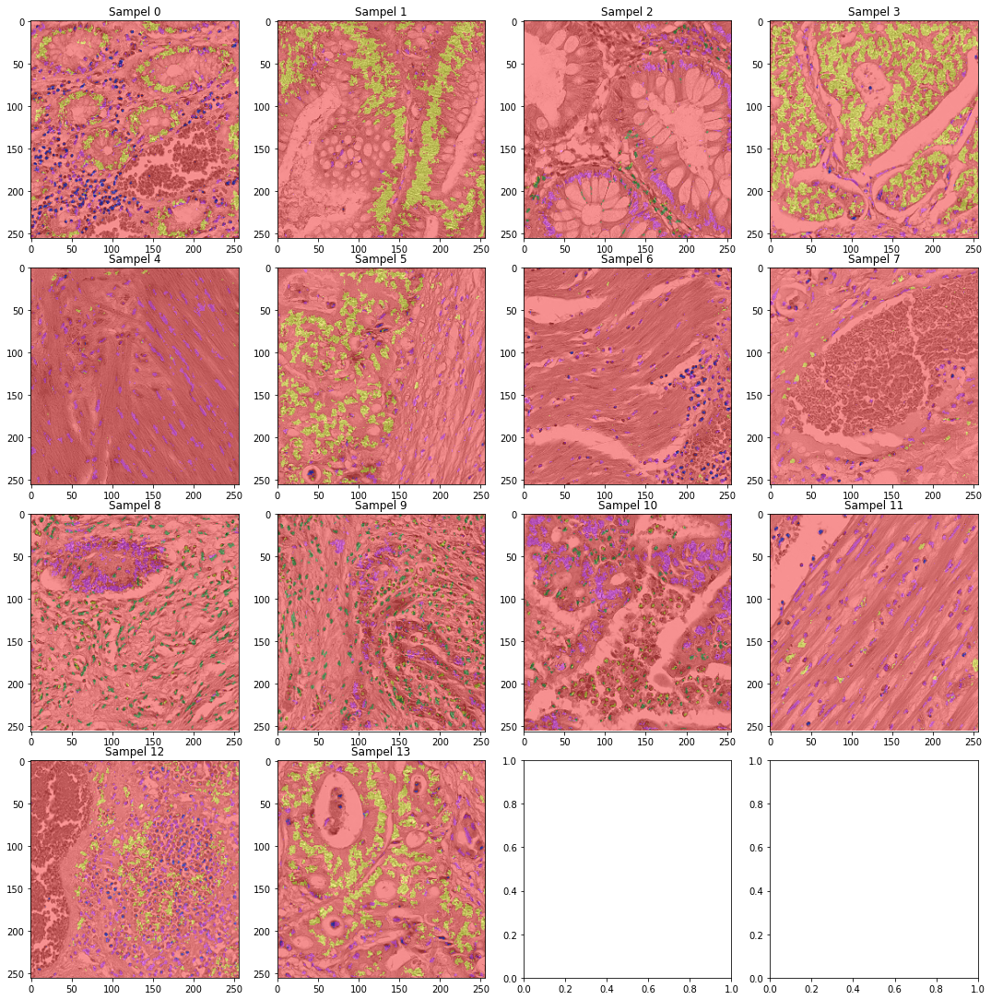

In [ ]:
plotAllSegmentations(X_test, model.predict(x_test, batch_size=1))